# The Posner-Becker corpus over time (no comments)

## Data parsing and filtering

In [2]:
import bisect
import datetime
import json
import matplotlib.pyplot as plt
import matplotlib.ticker as ticker
import nltk
import numpy as np
import pandas as pd
import re
import scipy
import seaborn as sns
import spacy
import string

from bertopic import BERTopic
from collections import Counter, defaultdict
from difflib import ndiff
from flair.data import Sentence
from flair.models import TextClassifier
from gensim import corpora, models
from matplotlib import gridspec
from nltk.corpus import stopwords
from pprint import pprint
from scipy.cluster import hierarchy as sch
from sklearn.cluster import DBSCAN
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.metrics.pairwise import cosine_similarity
from spacy.lang.en.stop_words import STOP_WORDS
from spacytextblob.spacytextblob import SpacyTextBlob
from tqdm import tqdm
from transformers import RobertaTokenizerFast
from umap.umap_ import UMAP

In [3]:
def levenshtein(str_1, str_2):
    distance = 0
    buffer_removed = buffer_added = 0
    for x in ndiff(str_1, str_2):
        code = x[0]
        if code == ' ':
            distance += max(buffer_removed, buffer_added)
            buffer_removed = buffer_added = 0
        elif code == '-':
            buffer_removed += 1
        elif code == '+':
            buffer_added += 1
    distance += max(buffer_removed, buffer_added)
    return distance

# nltk.download('punkt')

timestamps = []
texts = []
authors = []
comments = []
titles = []
post_types = []
sent_types = []

all_pars = []
all_sents = []
all_pars_timestamps = []
all_sents_timestamps = []

title_types = [["Farewell", "other"], ["Sabbatical Notice", "other"], ["The Embargo of Cuba: Time to Go- Becker", "leader"], ["End the Cuban Embargo—Posner", "comment"], ["Should Marijuana Be Decriminalized Nationwide?—Posner", "leader"], ["Why Marijuana Should be Decriminalized- Becker  ", "comment"], ["The War on Drugs", "other"], ["The Myth of Excess Enrollments in College-Becker  ", "leader"], ["Excess Enrollments in College? Could Be. Posner", "comment"], ["Has the United States, by Virtue of Its Size and Complexity, Become Ungovernable?—Posner", "leader"], ["Are Government Bureaucracies Too Big? Becker", "comment"], ["Generational Mobility in the United States-Becker  ", "leader"], ["Social Mobility and Income Inequality—Posner", "comment"], ["Should Partisan Gerrymandering Be Outlawed? Posner", "leader"], ["Neighborhood Gerrymandering- Becker", "comment"], ["Is the US in For Secular Stagnation: Déjà Vu All Over Again- Becker", "leader"], ["Secular Stagnation—Posner", "comment"], ["Bureaucracy and Efficiency—Posner", "leader"], ["Competition and the Efficiency of Bureaucracies- Becker", "comment"], ["Recent Mexican Reforms and the Impact on the United States-Becker", "leader"], ["Mexico’s Economic Reforms—Posner", "comment"], ["Does Redistributing Income from Rich to Poor Increase or Reduce Economic Growth or Welfare? Posner", "leader"], ["Redistribution and the Well-Being of the Poor-Becker", "comment"], ["The Consequences of Abandoning China’s One Child Policy- Becker", "leader"], ["China’s “One Child” Policy—Posner", "comment"], ["What should be done about the federal entitlements spending that is threatening the long-term solvency of the federal government?—Posner", "leader"], ["How to Control Entitlements, Especially Medicare-Becker", "comment"], ["Minimum Wages, Employment, and Inequality-Becker", "leader"], ["Raise the Federal Minimum Wage (But Not Too Far)—Posner", "comment"], ["", "other"], ["Notice", "other"], ["Is Opportunity Declining? Becker", "leader"], ["Equality of Opportunity-Posner", "comment"], ["Why Does College Cost So Much? Posner", "leader"], ["Higher College Costs and its Consequences- Becker", "comment"], ["Ceilings on Government Debt, Taxes, and Government Spending-Becker", "leader"], ["The Debt Ceiling—Posner", "comment"], ["Is it realistic to think that federal spending can be cut substantially in either the short or the long run? Posner", "leader"], ["Can Government Programs be Cut Back? Becker  ", "comment"], ["Capitalism’s Return from the Financial Crisis-Becker", "leader"], ["Has Capitalism Revived/Survived? Posner", "comment"], ["When Should We Interfere in Another Country’s Internal Affairs? Posner", "leader"], ["Bombing Syria? Becker  ", "comment"], ["Dynamic Competition and Anti Trust Policy-Becker  ", "leader"], ["Microsoft’s Dilemma—Posner", "comment"], ["President Obama’s Plan for College Reform—Posner", "leader"], ["Information About Colleges and Student Loans-Becker", "comment"], ["Low Birth Rates: Causes, Consequences, and Remedies-Becker  ", "leader"], ["Does the World Need More People? Posner", "comment"], ["Poverty and Near-Poverty in the United States--Posner", "leader"], ["Education and the Growth of Poverty in United States-Becker  ", "comment"], ["Technological Change and Natural Resource Prices-Becker", "leader"], ["Commodity Price Fluctuations—Posner", "comment"], ["Patent Trolls—Posner", "leader"], ["On Reforming the Patent System -Becker", "comment"], ["The Sequester Is a Failure—Posner", "leader"], ["Has the Government Spending Sequestration Hurt the Economy? Becker", "comment"], ["Should There Be a Carbon Emissions Tax? Posner", "leader"], ["What Should a Carbon Tax Look Like? Becker  ", "comment"], ["The Senate Bill on Immigration Reform-Becker", "leader"], ["What to Do About Immigration, Legal and Illegal? Posner", "comment"], ["Does Medical Care Cost Too Much in the United States? Posner", "leader"], ["Medical Competition and the Cost of Medical Care-Becker", "comment"], ["Reform of the Tax Code-Becker", "leader"], ["Tax Reform—Posner", "comment"], ["Abenomics and Japan’s Stagnation-Becker  ", "leader"], ["Should the European Union Emulate Japan's Inflationary Monetary Policy?—Posner ", "comment"], ["China’s Tilt Toward the Private Sector? Becker  ", "leader"], ["The Chinese Economy—Posner", "comment"], ["Security Surveillance Cameras—Posner", "leader"], ["The Internet, Surveillance Cameras, and Misuse of Big Data-Becker", "comment"], ["The Rise in College Tuition and Student Loans-Becker", "leader"], ["College Costs and Quality—Posner", "comment"], ["Breakthough in the War on Drugs?—Posner", "leader"], ["Alternatives to the War on Drugs-Becker", "comment"], ["Reforming Immigration Policy-Becker", "leader"], ["Reforming Immigration Policy—Posner", "comment"], ["Business Ethics—Posner", "leader"], ["Business, Competition, and Corruption-Becker", "comment"], ["The Decline in Illegal Immigration From Mexico-Becker", "leader"], ["Mexican Immigration to the United States—Posner", "comment"], ["Automation and Employment--Posner", "leader"], ["The Dismal Future for Workers With Few Skills-Becker", "comment"], ["Extending Social Security and Medicare Eligibility Ages-Becker  ", "leader"], ["Extending the Social Security and Medicare Eligiblity Ages—Posner", "comment"], ["Some Economics of Higher Education—Posner", "leader"], ["Higher Education is Still a Very Good Investment-Becker  ", "comment"], ["Will the Sequester Be an Economic Disaster? Becker", "leader"], ["The Sequester-Posner", "comment"], ["Should the Minimum Wage Be Raised to $9?—Posner", "leader"], ["Is Raising the Minimum Wage a Good Idea? Becker", "comment"], ["Contrived Inequality and Equality-Becker", "leader"], ["Contrived and Natural Inequality—Posner", "comment"], ["Rules versus Discretion in Financial and Other Regulation—Posner", "leader"], ["Why I Favor Rules Over Discretion-Becker", "comment"], ["Why Has Competition to Get into Top Colleges Become Much Tougher? Becker", "leader"], ["Competition to Get Into the Best Colleges—Posner", "comment"], ["Should There Be a Debt Ceiling?—Posner", "leader"], ["On the Debt Ceiling-Becker", "comment"], ["Why Does Health in the United States Lag Behind Other Countries’? Becker", "leader"], ["Comparative Longevity—Posner", "comment"], ["More on the Fiscal Cliff—Posner", "leader"], ["How Good is the Fiscal Agreement? Becker", "comment"], ["Meritocracies and Intergeneration Mobility-Becker", "leader"], ["Meritocracy, Social Mobility, Intergenerational Mobility—Posner", "comment"], ["The Fiscal Cliff--Posner", "leader"], ["Spending, Taxation, and the Fiscal Cliff-Becker", "comment"], ["The Becker-Posner Blog: Now on Facebook", "other"], ["The Unemployment Rate and Central Bank Policy-Becker", "leader"], ["Unemployment, Inflation, and the Fed—Posner", "comment"], ["The Professional versus the Business Model in Law and Medicine--Posner", "leader"], ["Is the Business Model Worse Than the Professional Model? Becker", "comment"], ["Breakup of Countries: No Economic Disaster- Becker", "leader"], ["The Optimal Size of Countries--Posner", "comment"], ["MOOCs—Implications for Higher Education—Posner", "leader"], ["Online Courses and the Future of Higher Education-Becker", "comment"], ["Why People Vote and What That Implies-Becker", "leader"], ["The Paradox of Voting--Posner", "comment"], ["What to Do about Illegal Immigration--Posner", "leader"], ["What to Do About Illegal Immigration? Becker ", "comment"], ["The High Unemployment Rate and its Social Cost-Becker", "leader"], ["The Problem of the Long-Term Unemployed--Posner", "comment"], ["Is Banking Unusually Prone to Risky Practices? Posner", "leader"], ["Government Regulation, Competition, and Corruption-Becker", "comment"], ["What Limits to Using Money Prices to Buy and Sell? Becker", "leader"], ["Sale of Body Parts—Posner", "comment"], ["Luck, Wealth, and Implications for Policy--Posner", "leader"], ["Luck and Taxation-Becker", "comment"], ["Will Long-Term Growth Slow Down? Becker", "leader"], ["Will U.S. Economic Growth Slow? Posner", "comment"], ["Do patent and copyright law restrict competition and creativity excessively? Posner", "leader"], ["Reforming the Patent System Toward a Minimalist System-Becker", "comment"], ["Good and Bad Teachers: How to Tell the Difference-Becker", "leader"], ["Rating Teachers—Posner", "comment"], ["Notice", "other"], ["Time for China’s One-Child Policy to Go-Becker", "leader"], ["China’s One-Child Policy—Posner", "comment"], ["Is Banking Unusually Corrupt, and If So, Why? Posner", "leader"], ["Is Banking Unusually Corrupt? Becker", "comment"], ["Is Raising Marginal Tax Rates on Higher Income Individuals a Good Idea? Becker", "leader"], ["The Economic Effects of Increasing Marginal Income Tax Rates—Posner", "comment"], ["Why Is Job Growth Tepid?—Posner", "leader"], ["The Worst Recovery Since World War II-Becker", "comment"], ["The Health Care Mandate: If it seems Like a Tax it is a Tax-Becker", "leader"], ["Is the Health Care Law’s “Mandate” Really a Tax?—Posner ", "comment"], ["Why Are Americans More Religious than Europeans? Posner", "leader"], ["Why are Americans More Religious than Western Europeans? Becker", "comment"], ["Controls Over consumer Choices- Becker", "leader"], ["Bloomberg, Sugar, and Obesity—Posner", "comment"], ["Correction--Posner", "other"], ["The Federal Reserve and the World Economic Crisis—Posner", "leader"], ["Is Further Quantitative Easing by the Fed Warranted? Becker", "comment"], ["Profits, Competition, and Social Welfare-Becker", "leader"], ["Capitalism—Posner", "comment"], ["Is Student Debt Excessive? Posner", "leader"], ["Is Student Debt Too Great? Becker", "comment"], ["Should Greece Exit the Euro Zone? Becker", "leader"], ["Should Greece Abandon the Euro? Posner", "comment"], ["Homosexual Marriage—Posner", "leader"], ["On Homosexual Marriage-Becker", "comment"], ["Why has the Recovery in Employment in the US been so Slow? Becker", "leader"], ["Why Unemployment Remains So High—Posner", "comment"], ["Are the Incentives of College Administrators Well Aligned with Social Welfare? Posner", "leader"], ["Are the Incentives of Colleges Aligned With Social Welfare? Becker", "comment"], ["Concern About The Decline in Manufacturing in the United States? Becker", "leader"], ["Decline of U.S. Manufacturing—Posner", "comment"], ["Notice", "other"], ["Unlimited Campaign Spending—A Good Thing? Posner", "leader"], ["Restrictions on Campaign Contributions- A Good Thing? Becker", "comment"], ["Fracking and Self-Sufficiency in Gas and Oil-Becker", "leader"], ["Energy Self-Sufficiency—Posner", "comment"], ["Should public school teachers have tenure? Posner", "leader"], ["Should K-12 Teachers Have Tenure? Becker", "comment"], ["On the Apparently Growing Class Divide and What can be Done About it-Becker", "leader"], ["The Growing Class Divide—Posner", "comment"], ["Are Bookstores and Libraries Doomed by Digitization? Posner", "leader"], ["Traditional Bookstores and Libraries are Doomed by the Internet, and so too are Many Other Ways to Distribute Content to Consumers-Becker", "comment"], ["Is China’s Economic Future a Rosy One?  Becker", "leader"], ["Will China Overtake Us? Posner", "comment"], ["Amnesty for Illegal Immigrants? Posner", "leader"], ["Illegal Immigration-Becker", "comment"], ["Is Capitalism in Crisis? Becker", "leader"], ["Is Capitalism in Crisis? Posner", "comment"], ["Physician-Assisted Suicide—Posner", "leader"], ["Suicide and its Assistance-Becker", "comment"], ["Wealth and Income Taxes on the Rich-Becker", "leader"], ["Taxing Wealthy People More Heavily—Posner", "comment"], ["Notice", "other"], ["Notice", "other"], ["Does America Imprison Too Many People? Posner", "leader"], ["Does America Imprison Too Many People? Becker", "comment"], ["The Euro Crisis and Euro Bonds-Becker", "leader"], ["The Question of Eurobonds—Posner", "comment"], ["Occupy Wall Street-Posner", "leader"], ["The Occupy Wall Street Movement-Becker", "comment"], ["Has Structural Unemployment Become Important in the United States? Becker", "leader"], ["Structural Unemployment: Posner", "comment"], ["How the United States Is Like, and Unlike, Greece—Posner", "leader"], ["Greece and the Euro-Becker", "comment"], ["Notice", "other"], ["Notice", "other"], ["Notice", "other"], ["Too Many Government Workers?—Posner", "leader"], ["Government Workers and Fiscal Problems-Becker", "comment"], ["Market Failure Compared to Government Failure -Becker", "leader"], ["The Nirvana Fallacy Revisited—Posner", "comment"], ["Obama’s Jobs Speech—Posner", "leader"], ["A Second Stimulus Package? Becker", "comment"], ["In Trouble Once Again: What to do About US Post Office? Becker", "leader"], ["Whither the Post Office and Its Universal Service Obligation? Posner", "comment"], ["Warren Buffett on Taxing the Wealthy More Heavily—Posner", "leader"], ["Buffett and a Better Tax System-Becker", "comment"], ["Deserving and Undeserving Inequality–Becker", "leader"], ["Income Inequality and Envy—Posner", "comment"], ["The English Riots—Posner", "leader"], ["Riots-Becker", "comment"], ["The Challenge of Cyberwarfare and Cyberspying -Becker", "leader"], ["The Challenge of Cyber Warfare—Posner", "comment"], ["The Depression, the Deficit Debacle, and the Debt-Ceiling Crisis—Posner", "leader"], ["Immediate and Medium Term Debt and Deficit Problems-Becker", "comment"], ["The Abysmal Recovery in Employment- Becker", "leader"], ["What to Do about Unemployment in the Short Term?—Posner", "comment"], ["The Federal Deficit Mess—Posner", "leader"], ["Short and Long Term United States Fiscal Crises-Becker", "comment"], ["Will Large-Scale Illegal Immigration from Mexico Come to an End? Becker", "leader"], ["The Decline in Immigration from Mexico: What It Means for the United States—Posner", "comment"], ["Primary-Care Physicians and the Reform of Health Care—Posner", "leader"], ["Is There a Shortage of Primary Care Physicians? Becker", "comment"], ["Fluctuations in Oil Prices, Speculation, and Strategic Reserves-Becker", "leader"], ["Releasing Oil from Reserves—Posner", "comment"], ["Why the economic recovery is lagging—Posner", "leader"], ["The Slow Economic Recovery-Becker", "comment"], ["“Capture” of Regulators by Fannie Mae and Freddie Mac-Becker", "leader"], ["Capture Theory and the Financial Crisis—Posner", "comment"], ["Legacy Admissions to Colleges and Universities—Posner", "leader"], ["Legacy Preferences Make a Lot of Sense, Up to a Point-Becker", "comment"], ["Another Tech Bubble in the Offing? Becker", "leader"], ["Is There a Social-Network Bubble? Posner", "comment"], ["Life Extension versus Quality-of-Life Enhancement—Posner ", "leader"], ["Are There Sizable Benefits From Extending the Lives of the Old and Frail? Becker  ", "comment"], ["Subsidies to Oil and Other Energy Sources-Becker", "leader"], ["The U.S. Tax Subsidies for Oil Companies—Posner", "comment"], ["Does the Earth Have Room for 10 Billion People? Posner", "leader"], ["Yes, the Earth Will Have Ample Resources for 10 Billion People-Becker", "comment"], ["Can Poor Countries Afford Democracy? Becker", "leader"], ["Can Poor Countries Afford Democracy?—Posner", "comment"], ["Consumer Protection in the Airline Industry—Posner", "leader"], ["How Can Governments Help Consumers- Becker", "comment"], ["How to (and not to) Help Poor Families in Developing Countries Cope with Rising Food Prices-Becker", "leader"], ["Commodity Price Inflation—Posner", "comment"], ["Paul Ryan’s Budget Proposal—Posner", "leader"], ["Paul Ryan’s Roadmap for America’s Budgetary Future-Becker", "comment"], ["The NCAA as a Powerful Cartel-Becker", "leader"], ["Monopsony in College Athletics—Posner", "comment"], ["Public-Employee Unions—Posner", "leader"], ["Government Sector Unions-Becker", "comment"], ["The Economic Implications of the Japanese Earthquake Disaster and its Aftermath-Becker", "leader"], ["The Japanese Catastrophe—Posner", "comment"], ["What Is a College Degree Really Worth?—Posner", "leader"], ["Are Too Many Young People Going to College? Becker", "comment"], ["The Middle East Uprisings, their Economies, and the World Economy-Becker", "leader"], ["The Middle East Uprisings and the Economy—Posner", "comment"], ["The Overdiagnosis Problem—Posner", "leader"], ["How Beneficial is Widespread Medical Screening? Becker", "comment"], ["What Kind of Gun Control? Becker", "leader"], ["Gun Control—Posner’s Comment", "comment"], ["Why Dictatorial Regimes Are Brittle—Posner", "leader"], ["Abrupt Change of Authoritarian Regimes-Becker", "comment"], ["Bad and Good Inequality-Becker", "leader"], ["Inequality in Income and Wealth—Posner", "comment"], ["The Crisis in Microfinance—Posner", "leader"], ["Overselling of Microfinance-Becker", "comment"], ["The Case for Tuition Increases at Public Universities-Becker", "leader"], ["Raising Public-College Tuition—Posner ", "comment"], ["Can Bookstores Survive? Prospects and Consequences—Posner", "leader"], ["Traditional Bookstores are Doomed-Becker", "comment"], ["Implications of International Comparisons of Student Performance-Becker", "leader"], ["The PISA Rankings and the Role of Schools in Student Performance on Standardized Tests—Posner", "comment"], ["The Tax and Spending Compromise-Becker", "leader"], ["The Tax Deal: A Second Stimulus?—Posner", "comment"], ["The Dismal State of Long-Term State and Local Government Finance-Becker", "leader"], ["State and Local Government: The Fiscal Crisis—Posner", "comment"], ["Note to Drug Legalization Post", "other"], ["Drug Legalization—Posner", "leader"], ["The American War on Drugs is Not Only an American Disaster-Becker", "comment"], ["The Sluggish US Employment Picture-Becker", "leader"], ["Unemployment—Posner", "comment"], ["A Further Comment on Contraception and Catholicism—Posner", "response"], ["Contraception and Catholicism—Posner", "leader"], ["The Behavior of Catholics and Contraceptive Use-Becker", "comment"], ["Public Policies and Rising World Food Prices Once Again-Becker", "leader"], ["Global Food Prices—Posner", "comment"], ["Quantitative Easing—Posner", "leader"], ["Why I Do Not Like QE2-Becker", "comment"], ["An Economic Growth and Deficit Reduction Agenda for Congress and the President- Becker", "leader"], ["The New Congress and Economic Growth—Posner’s Comment", "comment"], ["The United Kingdom’s Dramatic Response to the Economic Crisis—Posner", "leader"], ["Contrasts Between the US’s and UK’s Post-Recession Policies-Becker", "comment"], ["Will the Earnings of Women Overtake Those of Men? Becker", "leader"], ["Male and Female Earnings Trends—Posner", "comment"], ["The Controversy over Birthright Citizenship—Posner", "leader"], ["Should Children Born in the United States Automatically Become Citizens? Becker", "comment"], ["Democracy or Autocracy: Which is Better for Economic Growth? Becker", "leader"], ["Autocracy, Democracy, and Economic Welfare—Posner", "comment"], ["The Value-Added Teacher Reform Program—Posner", "leader"], ["Incentives to Teachers and Students-Becker", "comment"], ["Notice", "other"], ["Higher Education and Technological Advances as Countries Develop-Becker", "leader"], ["Education and Innovation in Developing Countries—Posner", "comment"], ["Is the Federal Government Broke? Posner", "leader"], ["How Dismal is the Fiscal Future For America and Europe? Becker", "comment"], ["Will the Next Generation be Better off Than Their Parents’ Generation? Becker", "leader"], ["The Decline in American Optimism—Posner", "comment"], ["Our Limping Economic Recovery—Posner", "leader"], ["The Slowdown in the Economic Recovery-Becker", "comment"], ["Germany vs. US: Two Different Approaches to the Recession-Becker", "leader"], ["German Employment—Posner", "comment"], ["Unionism and Economic Recovery—Posner", "leader"], ["Unions and the Obama Administration-Becker", "comment"], ["correction", "other"], ["Should Unemployment Compensation be Extended? Becker", "leader"], ["Against Extending Unemployment Benefits—Posner", "comment"], ["Abuse of Presidential Power? Posner", "leader"], ["The Abuse of Presidential Power-Becker", "comment"], ["Five Major Defects of the Financial Reform Bill-Becker", "leader"], ["The Financial Regulation Law—Posner’s Comment", "comment"], ["The  Gulf Oil Leak—Posner", "leader"], ["The Gulf Oil Leak and Optimal Safety Precautions-Becker", "comment"], ["How to Greatly Reduce the Fiscal Burden of Entitlements-Becker", "leader"], ["The Entitlements Quandary—Posner", "comment"], ["The Controversy over For-Profit Colleges—Posner", "leader"], ["Default Rates and For-Profit Colleges- Becker", "comment"], ["Notice", "other"], ["Will Africa Finally Take Off? Becker", "leader"], ["Is Sub-Saharan Africa at a Turning Point? Posner", "comment"], ["Europe’s Long-Term Economic Woes—and America’s", "leader"], ["Slow Economic Growth is a Crucial European Problem-Becker", "comment"], ["Central Bank Independence-Becker", "leader"], ["Should Central Banks Be Politically Independent? Posner", "comment"], ["Asset-Price Bubbles—Posner", "leader"], ["Social Interactions and Bubbles-Becker", "comment"], ["Slow Recovery in US Employment? Becker", "leader"], ["Stubbornly High Unemployment—Posner", "comment"], ["Did Speculation Make the Economic Crisis Deeper or Shallower? Posner", "leader"], ["The Value of Profitable Speculation-Becker", "comment"], ["Should the US Introduce a Value Added Tax? Becker", "leader"], ["Should the United States Institute a Federal Value-Added Tax? Posner", "comment"], ["American Wage Stagnation—Posner", "leader"], ["Trends in American Income Inequality Prior to the Recession-Becker", "comment"], ["The Looming Entitlement Fiscal Burden-Becker", "leader"], ["The Entitlement Quandary—Posner", "comment"], ["The End of Marriage? Posner", "leader"], ["The Effects on Children of the Decline in Marriage-Becker", "comment"], ["The Health Care Bill: Progress or Retrogression? Becker", "leader"], ["The Health Care Bill—Posner’s Comment", "comment"], ["Greece’s Economic Crisis—Posner", "leader"], ["Will the Euro Survive its Current Difficulties? Becker", "comment"], ["The Long-Term Unemployed: Consequences and Possible Cures-Becker", "leader"], ["Long-Term Unemployment—Posner", "comment"], ["Should the Senate Abolish the Filibuster? Posner", "leader"], ["The Filibuster and Supermajorities-Becker", "comment"], ["Fiscal Stimulus Packages: What are their Effects? Becker", "leader"], ["Stimulus: Pluses and Minuses—Posner", "comment"], ["Double Exports in Five Years? Posner", "leader"], ["Should the Government try to Stimulate US Exports? Becker", "comment"], ["Are e-Readers the Beginning of the End for Books? Becker", "leader"], ["Will Printed Books Soon Be Obsolete? Posner", "comment"], ["The Question of Consumer Competence—Posner", "leader"], ["On Consumer Competence-Becker", "comment"], ["Subsidies to Small Business? Becker", "leader"], ["The Job-Subsidy Plan—Posner", "comment"], ["Optimal Protection against Terrorist Attacks on Airlines—Posner", "leader"], ["Fear, Profiling, and Terrorism on Airplanes-Becker", "comment"], ["Notice", "other"], ["The Internet, Competition, and Censorship-Becker", "leader"], ["The Internet, Competition, and Censorship—Posner’s Comment", "comment"], ["Why Aren’t Americans Happier?—Posner", "leader"], ["Happiness and Wellbeing- Becker", "comment"], ["The Revolution in the Economic Empowerment of Women-Becker", "leader"], ["Should the Government Use Its Monopsony Power to Reduce the Price of Drugs? Posner", "leader"], ["Government Demand for Drugs and Drug Prices-Becker", "comment"], ["Failure in Copenhagen-Becker", "leader"], ["The Copenhagen Debacle: Where Do We Go from Here? Posner", "comment"], ["Should We Jettison GDP As an Economic Measure? Posner", "leader"], ["We Should Amend, not Discard, National Income Accounts-Becker", "comment"], ["Should the Fed Remain Independent? Becker", "leader"], ["Should the Fed Remain Independent? Posner", "comment"], ["Announcement: The Becker-Posner Blog Has Moved", "other"], ["The President's Forthcoming \"Jobs Summit\"--Posner", "leader"], ["How to Increase Employment- Becker", "comment"], ["Should China Allow its Currency to Appreciate? Becker", "leader"], ["China's Currency and Reserves--Posner", "comment"], ["Will We Go the Way of Japan?--Posner", "leader"], ["Will We Go the Way of Japan? No, Unless US Government Policies Discourage Growth-Becker", "comment"], ["Productivity and Jobs-Becker", "leader"], ["Productivity and Unemployment--Posner", "comment"], ["Fiscal Imprudence, Distributive Injustice: the $250 per Social Security Annuitant Plan--Posner", "leader"], ["Fiscal Imprudence and Fiscal Stimulus-Becker", "comment"], ["Notice", "other"], ["Pay Controls Once Again-Becker", "leader"], ["Pay Caps for Financial Executives--Posner", "comment"], ["The Economics of Organizations--Posner", "leader"], ["Competition and Organizational Efficiency-Becker", "comment"], ["Notice", "other"], ["Will World Food Prices Resume their Sharp Increase? Becker", "leader"], ["Will Food Prices Begin Increasing Again? Posner's Comment", "comment"], ["Should the Swiss Health Care System Be Our Model?--Posner", "leader"], ["Is the Swiss Health Care System a Good Model for US? Becker", "comment"], ["Union Power in the Obama Administration-Becker", "leader"], ["The Tariff on Chinese Tires--Posner's Comment", "comment"], ["Notice", "other"], ["Do Deficits Matter? Posner", "leader"], ["How Much Should We Care About Government Deficits? Becker", "comment"], ["Productivity, Unemployment, and the End of the Recession-Becker", "leader"], ["Unemployment and Depression--Posner", "comment"], ["Notice", "other"], ["Do We Need More Regulation of Mortgages to Protect Consumers?--Posner", "leader"], ["More Regulation of Mortgages would Likely Hurt Consumers-Becker", "comment"], ["The Cash for Clunkers Program: A Bad Idea at the Wrong Time-Becker", "leader"], ["Cash for Clunkers--Posner's Comment", "comment"], ["Health Care, Cost, and Insurance Theory--Posner", "leader"], ["American Health Care Once Again-Becker", "comment"], ["Notice", "other"], ["The World Recession is Ending: What Next? Becker", "leader"], ["It", "comment"], ["Health Reform and Obesity--Posner", "leader"], ["Mortality from Disease and the American Health Care System-Becker", "leader"], ["American Health Care--Posner's Comment", "comment"], ["The Drop in University Endowments and What to Do about It--Posner", "leader"], ["How Should Universities React to the Decline in Their Endowments? Becker", "comment"], ["Legislation on Clean Energy-Becker", "leader"], ["The Cap and Trade Carbon-Emissions Bill--Posner", "comment"], ["The Senate and the Filibuster--Posner", "leader"], ["The Senate Filibuster -Becker", "comment"], ["President Obama's Financial Reform Package-Becker", "leader"], ["Financial Regulatory Reform--Posner's Comment", "comment"], ["The Future of Newspapers--Posner", "leader"], ["The Social Cost of the Decline of Newspapers?Becker", "comment"], ["Notice", "other"], ["The Fatal Conceit: A Pay \"Czar\"-Becker", "leader"], ["The Pay Czar and Compensation Issues--Posner's Comment", "comment"], ["The Administration's Health Care Plan--Posner", "leader"], ["Health Care-Becker", "comment"], ["Is the World Economic Center of Gravity Moving to Asia? Becker", "leader"], ["Is Asia Becoming the Center of the World Economy? Posner", "comment"], ["A Soda or Calorie Tax to Reduce Obesity--Posner", "leader"], ["A Tax on Sodas? Becker", "comment"], ["The Conflict in Modern Conservatism Once Again-Becker", "leader"], ["Conservatism II--Posner's Comment", "comment"], ["Is the Conservative Movement Losing Steam? Posner", "leader"], ["The Serious Conflict in the Modern Conservative Movement-Becker", "comment"], ["Announcement-Posner", "other"], ["Some Economics of Flu Pandemics-Becker", "leader"], ["Is the Federal Reserve Losing Its Independence? Posner", "leader"], ["Central Banks Cannot Easily Maintain their Independence- Becker", "comment"], ["Repayment of Tarp Bank Loans-Becker", "leader"], ["Repaying the Government's Loans to the Banks--Posner's Comment", "comment"], ["Is the Stock Market an \"Efficient\" Market?--Posner", "leader"], ["Comments on the Efficiency of Stock Markets-Becker", "comment"], ["Reply to Comment on Housing--Posner", "response"], ["Housing Prices and Consumption-Becker", "leader"], ["Housing Prices, Wealth, and the Current Depression--Posner's Comment", "comment"], ["An Addendum on the Treasury's Plan to Buy Bank Assets-Becker", "response"], ["Housing Prices, Wealth, and the Current Depression--Posner's Comment", "leader"], ["The Treasury's Plan to Buy Bank Assets-Becker", "comment"], ["Match Making through the Internet-Becker", "leader"], ["Internet Matching--Posner's Comment", "comment"], ["Tax Deductions for American Charitable Donations Abroad--Posner", "leader"], ["American Charitable Deductions Abroad-Becker", "comment"], ["Financial Regulations-Becker", "leader"], ["Re-Regulating the Banking Industry--Posner", "comment"], ["Notice", "other"], ["China Bashing Once Again-Becker", "leader"], ["China and the U.S. Depression--Posner", "comment"], ["Notice", "other"], ["Against the Pay Caps--Posner", "leader"], ["Pay Controls Do Not Work at Any Level-Becker", "comment"], ["Buy American Once Again-Becker", "leader"], ["Protectionism in a Depression--Posner", "comment"], ["Protectionism in a Depression--Posner", "other"], ["The Employee Free Choice Act--Posner", "leader"], ["Will the Decline in Union Membership be Reversed? Becker", "comment"], ["Infrastructure in a Stimulus Package-Becker", "leader"], ["Infrastructure in a Stimulus Package-Becker", "other"], ["Deficit Spending on Infrastructure in a Depression--Posner", "comment"], ["The Obama \"Stimulus\" (Deficit Spending) Plan--Posner", "leader"], ["On the Obama Stimulus Plan-Becker", "comment"], ["Is This a Good Time to Raise Taxes on Gasoline? Becker", "leader"], ["Raise Gasoline Taxes Now? Posner's Comment", "comment"], ["Can the United Auto Workers Survive? Posner", "leader"], ["Unions in the American Economy-Becker", "comment"], ["The Madoff Ponzi Scheme-Becker", "leader"], ["Bernard Madoff and Ponzi Schemes--Posner's Comment", "comment"], ["The Auto Bailout Issue‚ÄîPosner", "leader"], ["Why Bankruptcy is the Best Solution for American Auto Companies--Becker", "comment"], ["Central Bank Confidence in Taming the Business Cycle: A Grand Illusion? Becker", "leader"], ["Macroeconomic Policy and the Current Depression--Posner", "comment"], ["The Future of Conservatism--Posner", "leader"], ["The Future of Free Market Conservatism- Becker", "comment"], ["Notice", "other"], ["Bail Out the Big Three Auto Producers? Not a Good Idea-Becker", "leader"], ["Bail Out the Detroit Auto Manufacturers? Posner's Comment", "comment"], ["Do Depressions Have a Silver Lining? Posner", "leader"], ["Depressions Cause a lot More Pain than Benefits-Becker", "comment"], ["Does the Free Market Corrode Moral Character?-Becker", "leader"], ["Does the Free Market Corrode Moral Character? Posner's Comment", "comment"], ["The Controversy over the Milton Friedman Institute--Posner", "leader"], ["Observations on the Milton Friedman Institute at the University of Chicago-Becker", "comment"], ["Is the Goose that Laid the Golden Eggs Severely Wounded? Becker", "leader"], ["Has the Market Economy Failed? Posner", "comment"], ["The Financial Crisis: Why Were Warnings Ignored?--Posner", "leader"], ["Why the Warnings were Ignored: Too many False Alarms-Becker", "comment"], ["Government Equity in Private Companies: A Bad Idea-Becker", "leader"], ["Equities, Pay Caps, Liquidity: Structuring a Bailout--Posner", "comment"], ["The $700+ Billion Bailout--Posner", "leader"], ["The Financial Crisis II-Becker", "comment"], ["The Crisis of Global Capitalism?Becker", "leader"], ["The Financial Crisis: the Role of Government--Posner", "comment"], ["Prediction Markets and the Election--Posner", "leader"], ["Political Prediction Markets-Becker", "comment"], ["Competitive Markets and Discrimination Against Minorities-Becker", "leader"], ["Competition, Discrimination, and Law--Posner's Comment", "comment"], ["Notice", "other"], ["Why Is Hollywood Dominated by Liberals? Posner", "leader"], ["Hollywood and Liberals-Becker", "comment"], ["Determinants of the Olympic Success of Different Countries-Becker", "leader"], ["Financing the Olympic Games--Posner's Comment", "comment"], ["The Economics of Gay Marriage--Posner", "leader"], ["Should Gay Marriages be Allowed? Becker", "comment"], ["Is America in Decline? Becker", "leader"], ["Is America in Decline? Posner's Comment", "comment"], ["Compelled Disclosure of Food Characteristics--Posner", "leader"], ["Is Government Intervention in the Fast Food Industry Justified? Becker", "comment"], ["Should US Taxes on Gasoline be Higher? Becker", "leader"], ["Should Gasoline Taxes Be Raised or Lowered? Posner's Comment", "comment"], ["Trusts for Pets--Supplemental Comment--Posner", "response"], ["Should Dogs Get $8 Billion from the Helmsley Estate? Posner", "leader"], ["Cats and Dogs, and \"Sensible\" Bequests-Becker", "comment"], ["The Graying of College Faculties-Becker", "leader"], ["Aging Professors: Posner's Comment", "comment"], ["Are Newspapers Doomed?--Posner", "leader"], ["Yes, Newspapers are Doomed-Becker", "comment"], ["Energy Prices, Offshore Drilling, and an \"Excess\" Profits Tax-Becker", "leader"], ["Oil Prices, Offshore and Alaska Drilling, and Excess Profits Taxes--Posner's Comment", "comment"], ["Have We Lost the Moral Values That Undergird a Commercial Society?--Posner", "leader"], ["Borrowing and Consumption over the Life Cycle-Becker", "comment"], ["The Boom in College Education-Becker", "leader"], ["The Boom in College Education--Posner", "comment"], ["The Cost of Infrastructure Deterioration--Posner", "leader"], ["Infrastructure and the Value of Time-Becker", "comment"], ["Paying the Poor to Improve their School Performance-Becker", "leader"], ["Paying Children to Go to School--Posner's Comment", "comment"], ["Consumer Protection--Posner", "leader"], ["How Much government Regulation to \"Protect\" Consumers?Becker", "comment"], ["The Rise in the Price of Oil-Becker", "leader"], ["Why We Should Be Rooting for $200 per Barrel of Oil--Posner", "comment"], ["The Outlandish Farm Subsidies--Posner", "leader"], ["Farm Subsidies and Farm Taxes-Becker", "comment"], ["Greater Regulation of Financial Markets? Becker", "leader"], ["Re-Regulate Financial Markets?--Posner's Comment", "comment"], ["Why Is Airline Service So Bad? Posner", "leader"], ["The Decline of Airline Service-Becker", "comment"], ["Addendum on Rising Food Prices-Becker", "response"], ["Rising Food Prices and Public Policy-BECKER", "leader"], ["Food Prices and Malthusian Economics--Posner's Comment", "comment"], ["Compensation under Competition--Posner", "leader"], ["Risk-Taking by Top Executives-Becker", "comment"], ["Drugs and the Cost of Medicare -Becker", "leader"], ["The Medicare Challenge--Posner's Comment", "comment"], ["Intelligence Doping--Posner", "leader"], ["Comment on Intelligence Doping-Becker", "comment"], ["The Erosion of Individual Responsibility-BECKER", "leader"], ["Individual Responsibility--Posner's Comment", "comment"], ["William Buckley, Economics, and the Conservative Movement--Posner", "leader"], ["William F. Buckley and Economics-Becker", "comment"], ["The New Gender Gap in Education-Becker", "leader"], ["The New Gender Gap in Education--Posner's Comment", "comment"], ["Should Universities Have to Spend 5 Percent of Their Endowmen Annually?--Posner", "leader"], ["College Tuition and Endowments-Becker", "comment"], ["Can Gun Control Laws be Effective? Becker", "leader"], ["Gun Control--Posner's Comment", "comment"], ["Bill Gates on Corporate Philanthropy--Posner", "leader"], ["On Corporate Altruism-Becker", "comment"], ["Selling Illegal Residents the Right to Stay -Becker", "leader"], ["What (If Anything) to Do About Illegal Immigration--Posner's Comment", "comment"], ["Why Are Tax Burdens So Different in Different Developed Countries?--Posner", "leader"], ["Tax Burdens-Becker", "comment"], ["Slowing of Black Progress-Becker", "leader"], ["The Black-White Income Differential--Posner's Comment", "comment"], ["The Candidates' Health Care Reform Plans--Posner", "leader"], ["Potential Reforms of American Health Care-Becker", "comment"], ["Does Economic Development Reduce Terrorism? Becker", "leader"], ["Terrorism and Economic Development--Posner's Comment", "comment"], ["The Liberal Skew in Higher Education--Posner", "leader"], ["Events, Field, and the Liberal Skew in Higher Education-Becker", "comment"], ["The Subprime Housing Crisis -Becker", "leader"], ["The Subprime Mortgage Mess--Posner's Comment", "comment"], ["The UN's Human Development Index: A Critique--Posner", "leader"], ["How to Combine Income and Life Expectancy into an Index of Wellbeing-Becker", "comment"], ["Why Sovereign Funds? Becker", "leader"], ["Sovereign-Wealth Funds--Posner's Comment", "comment"], ["Notice", "other"], ["Carbon Offsets--Posner", "leader"], ["Why so Little Tax Evasion? Becker", "leader"], ["Tax Evasion--Posner's Comment", "comment"], ["Is the Bond Market the Best Predictor of the Outcome of a War?--Posner", "leader"], ["Iraqi Bonds and the Effects of the Surge-Becker", "comment"], ["Reply to Comments on Billionaires--Posner", "response"], ["Billionaires-Becker", "leader"], ["The Proliferation of Billionaires--Posner's Comment", "comment"], ["Why Is So Much Product Information False or Incomplete, Yet Not Misleading?--Posner", "leader"], ["Advertising and Product Information-Becker", "comment"], ["Notice", "other"], ["Rising Food Prices and What That Means-Becker", "leader"], ["Food Prices and Ethanol--Posner's Comment", "comment"], ["Should Hosts Be Liable for Serving Liquor to Guests Who Cause Accidents While Driving under the Influence?--And Other Issues of Third-Party Liability--Posner", "leader"], ["Third-Party Liability? Becker", "comment"], ["Globalization and Inequality-Becker", "leader"], ["Globalization and Inequality--Posner's Comment", "comment"], ["Free Speech--Posner's Reply to Comments", "response"], ["Free Speech in American Universities--Posner", "leader"], ["Intellectuals, Free speech, and Capitalism-Becker", "comment"], ["The Decline of Unions-Becker", "leader"], ["Universal National Service--Posner", "leader"], ["Universal National Service is a Tax, and a Bad One ‚ÄìBecker", "comment"], ["Rules vs. Authority in Central Bank (and Other) Policies-Becker", "leader"], ["Rules versus Discretion--Posner's Comment", "comment"], ["How to Control China's \"Export\" of Air Pollution--Posner", "leader"], ["China's Air Pollution-Becker", "comment"], ["The Transformation of the Kibbutz and the Rejection of Socialism-Becker", "leader"], ["The Kibbutz--Posner's Comment", "comment"], ["Infrastructure--Posner's Response to Comments", "response"], ["The Infrastructure \"Crisis\"--Posner", "leader"], ["The Infrastructure \"Crisis\" Once Again-Becker", "comment"], ["Responses to Comments on Air Transportation and on the Credit Crunch--Posner", "response"], ["Should Central Banks Intervene During This Financial Crisis? Becker", "leader"], ["Against Bailouts--Posner's Comment", "comment"], ["Air Transportation Delay--Posner", "leader"], ["Why Air Transportation Delays? Becker", "comment"], ["Response to Comments on Social Obesity--Posner", "response"], ["Social Causes of the Obesity \"Epidemic\"-Becker", "leader"], ["Social Obesity--Posner's Comment", "comment"], ["Decision Theory and the War in Iraq--Posner", "leader"], ["Comment on Benefit Cost Analysis Applied to the Iraq War-Becker", "comment"], ["Do National Security and Environmental Energy Policies Conflict? Becker", "leader"], ["Environment and National Security--Posner's Comment", "comment"], ["Hedge Funds and Rent-Seeking--Posner", "leader"], ["Comment on Hedge Funds--Becker", "comment"], ["Further Notice", "other"], ["Notice", "other"], ["The International Market for Talent-Becker", "leader"], ["Outsourcing and the International Market in Highly Skilled Workers--Posner's Comment", "comment"], ["Are Subprime Loans Useful? BECKER", "leader"], ["Subprime Mortgage Loans--Posner's Comment", "comment"], ["Women's Economic Role--Posner's Response to Comments", "response"], ["Intelligence and Leadership--Posner", "leader"], ["Intelligence and Leadership-BECKER", "comment"], ["Women's Role in the Economy-BECKER", "leader"], ["Women's Economic Role--Posner's Comment", "comment"], ["Ex Ante Compensation for Military Death--Posner", "leader"], ["Comment on Military Pay-BECKER", "comment"], ["Immigration Reform-BECKER", "leader"], ["Immigration Reform--Posner's Comment", "comment"], ["Notice", "other"], ["Family Control of Voting Stock in Newspapers and Other Media Companies--Posner", "leader"], ["Different Voting Classes of Shares, and Family Control of Newspapers-BECKER", "comment"], ["Crime and Economic Development-BECKER", "leader"], ["Crime and Corruption--Posner's Comment", "comment"], ["Protests against the War in Iraq--Posner's Reply to Comments", "response"], ["Why No Violent Protests Against the Iraq War?--Posner", "leader"], ["Protests and the Iraq War-BECKER", "comment"], ["Brief Response on Health Care and Tort Reform--Posner", "response"], ["The Benefits of Education-BECKER", "leader"], ["Is Higher Education a Good Investment?--Posner's Comment", "comment"], ["The Reform of Health Care--Posner", "leader"], ["Some Priorities in Reforming Health Care-BECKER", "comment"], ["Employee Ownership Through ESOPS:A Bad Bargain-BECKER", "leader"], ["The Economics of ESOPs--Posner's Comment", "comment"], ["Is the Tort System Costing the United States $865 Billion a Year?--Posner", "leader"], ["Private Property and Socialism: A Contradiction? BECKER", "leader"], ["Private Property in China--Posner's Comment", "comment"], ["Judicial Salaries--Posner", "leader"], ["How to Use Pensions to Improve Judicial Tenure-Becker", "comment"], ["Should Marriage be Subsidized? Becker", "leader"], ["Should Marriage Be Subsidized?--Posner's Comment", "comment"], ["The Economics of College and University Rankings--Posner", "leader"], ["Some Economics of Rankings-BECKER", "comment"], ["How to Conserve Water Efficiently-BECKER", "leader"], ["The Science and Economics of Water Shortage--Posner", "comment"], ["Should Genetic Testing Be Forbidden?--Posner", "leader"], ["Comment on Genetic Testing-BECKER", "comment"], ["Is Sex Selection of Births Undesirable? BECKER", "leader"], ["Correction", "other"], ["Sex Selection--Posner's Comment", "comment"], ["Global Warming--Posner's Response to Comments", "response"], ["Global Warming and Discount Rates--Posner", "leader"], ["Discounting Greenhouse Gas Effects in the Distant Future-BECKER", "comment"], ["Reforming the American Health Care System-BECKER", "leader"], ["Health Care Reform--Posner's Comment", "comment"], ["Correction--Posner", "other"], ["Should the United States Provide Foreign Aid?--Posner", "leader"], ["Is There a Case for Foreign Aid? BECKER", "comment"], ["Posner's Response to Comments on Libertarian Paternalism", "response"], ["Libertarian Paternalism: A Critique--BECKER", "leader"], ["Libertarian Paternalism--Posner's Comment", "comment"], ["AIDS in Africa--Posner's Response to Comments", "response"], ["Progress in Fighting AIDS in Africa?--Posner", "leader"], ["Charitable Foundations--Posner's Comment", "comment"], ["Responses on Drunken Driving and Trans Fats--BECKER", "response"], ["Fatalities from Drunken Driving--BECKER", "leader"], ["Drunk Driving--Posner's Comment", "comment"], ["The Trans Fats Ban--Posner's Response to Comments", "response"], ["Comment on the New York Ban on Trans Fats--BECKER", "leader"], ["The New York City Ban on Trans Fats--Posner", "leader"], ["Should We Worry about the Rising Inequality in Income and Wealth?--Posner", "leader"], ["World inequality--BECKER", "comment"], ["Is Student Debt Too High?--BECKER", "leader"], ["Should Congress Raise the Federal Minimum Wage?--Posner", "leader"], ["On Raising the Federal Minimum Wage--BECKER", "comment"], ["On Milton Friedman's Ideas--BECKER", "leader"], ["Milton Friedman--Posner's Comment", "comment"], ["What the Election Proves--Posner", "leader"], ["What the Election Proves? Not Much---BECKER", "comment"], ["Reply on Polygamy--BECKER", "response"], ["Crime Epidemics-BECKER", "leader"], ["Mexico's Crime Problem--Posner's Comment", "comment"], ["Microfinance and Third World Poverty and Development--Posner", "leader"], ["Comment on Microfinance-BECKER", "comment"], ["Is There a Case for Legalizing Polygamy? BECKER", "leader"], ["Should Polygamy Be Legal?--Posner's Comment", "comment"], ["Should We Worry about Overpopulation?--Posner", "leader"], ["Comment on Overpopulation-BECKER", "comment"], ["Taxing Fat-BECKER", "leader"], ["The Fat Tax--Posner's Comment", "comment"], ["Women in Science; DDT and Overpopulation--Posner's Response to Comments", "response"], ["The Shalala Report on Women in Science and Engineering--Posner", "leader"], ["Response on Malaria and DDT-BECKER", "response"], ["Correction--Posner", "other"], ["DDT and Deaths From Malaria ‚ÄìBECKER", "leader"], ["DDT, Malaria, and the Environment--Posner's Comment", "comment"], ["Identity Theft--Posner's Reply to Comments", "response"], ["Deterring Identity Theft--Posner", "leader"], ["On Identity Theft-BECKER", "comment"], ["Response on Test and Economic Performance-BECKER", "response"], ["Test Scores and Economic Performance-BECKER", "leader"], ["Our Bad Math Scores--Posner's Comment", "comment"], ["Doping in Sports-BECKER", "leader"], ["Doping Athletes--Posner's Comment", "comment"], ["Response to Comments on Stem Cell Research--Posner", "response"], ["The Economics of Stem-Cell Research--Posner", "leader"], ["Policy toward Stem Cell Research-BECKER", "comment"], ["Response on Counteracting Terrorism-BECKER", "response"], ["Response to Comments on Terrorism--Posner", "response"], ["Counteracting Terrorism-BECKER", "leader"], ["Terrorism-- Posner's Comment", "comment"], ["Internet Gambling--Posner", "leader"], ["Chicago's Approach to Big Boxes-BECKER", "leader"], ["The \"Big Box\" Minimum-Wage Ordinance--Posner's Comment", "comment"], ["Collective Punishment--Posner", "leader"], ["On Collective Punishment-BECKER", "comment"], ["Is the Growing Gender Gap in College Enrollments a Cause for Concern? BECKER", "leader"], ["Women's Academic Performance--Comment by Posner", "comment"], ["The Economics of the Revolving Door--Posner", "leader"], ["Turnover of High Level Public Employees-BECKER", "comment"], ["Response on Giving and Taxes-BECKER", "response"], ["Buffett and Giving-BECKER", "leader"], ["On Agricultural Subsidies by Rich Countries-BECKER", "leader"], ["Agricultural Subsidies--Comment by Posner", "comment"], ["Response on Privatizations-BECKER", "response"], ["Privatizing Highways--Posner's Response to Comments", "response"], ["Privatizing the Nation's Highways--and Other Infrastructure--Posner", "leader"], ["On Privatizing Highways and Other Functions--BECKER", "comment"], ["Notice", "other"], ["Antiterrorist Allocations--Posner's Response to Comments", "response"], ["The Cut in Antiterrorism Grants to New York and Washington, D.C.--Posner", "leader"], ["Antiterrorism Allocations--Becker", "comment"], ["Privatizing Security in Iraq and Elsewhere--Posner", "leader"], ["On Privatizing Security-BECKER", "comment"], ["Comment on Immigration Policy-BECKER", "response"], ["More Thoughts on Illegal Immigration--Posner", "response"], ["Are CEOS Overpaid, a Response-BECKER", "response"], ["Immigration Policy Once Again-BECKER", "leader"], ["The Illegal-Immigration Quandary--Posner", "comment"], ["Response on Moving Left in Latin America-BECKER", "response"], ["Are CEOs Overpaid?--Posner", "leader"], ["Are CEOS Overpaid? BECKER", "comment"], ["The Gasoline Price Spike: Another Nonissue--Posner", "leader"], ["Rising Gasoline Prices-BECKER", "comment"], ["Responses on Taxes and Inequality-BECKER", "response"], ["Posner's Response to Several Weeks of Comments", "response"], ["Is the Increased Earnings Inequality among Americans Bad? BECKER", "leader"], ["Why Rising Income Inequality in the United States Should Be a Nonissue--Posner", "comment"], ["Tax Complexity and the Cost of Compliance-BECKER", "leader"], ["Tax Simplification--Posner's Comment", "comment"], ["Should Lobbying and Campaign Spending Be Further Curtailed? Posner", "leader"], ["On Lobbying and Campaign Spending-BECKER", "comment"], ["The Latest French Riots--Posner", "leader"], ["Comment on the French Employment Law Riots-BECKER", "comment"], ["Reply on the Economics of the Iraqi War-BECKER", "response"], ["The Cost of the War in Iraq--Posner's Response to Comments", "response"], ["The Economics of the Iraq War--BECKER", "leader"], ["The Cost of the War in Iraq--Posner's Comment", "comment"], ["Dubai--Becker's Response to Comments", "response"], ["Dubai Ports Controversy--Posner's Response to Comments", "response"], ["The Dubai Ports World Fiasco--Posner", "leader"], ["Comment on the Dubai Ports World Fiasco--BECKER", "comment"], ["Response on Googling in China-BECKER", "response"], ["Summers' Resignation and Organization Theory--Posner", "leader"], ["Summers‚Äô Resignation and University Governance-BECKER", "comment"], ["Response on Traffic Congestion-BECKER", "response"], ["Google in China--Posner", "leader"], ["Googling in China-BECKER", "comment"], ["Response on Health Care Reform-BECKER", "response"], ["Response on Health Care-BECKER", "other"], ["The Solution to Traffic Congestion-BECKER", "leader"], ["Traffic Congestion--Posner's Comment", "comment"], ["Hamas, Palestine, and the Economics of Democracy--Posner", "leader"], ["A Comment on the Political Victory of Hamas-BECKER", "comment"], ["On For-Profit Colleges Again-BECKER", "response"], ["For-Profit Colleges-BECKER", "leader"], ["For-Profit Colleges and Universities--Posner's Comment", "comment"], ["Response on Tenure-BECKER", "response"], ["Tenure--Posner's Reply to Comments", "response"], ["Tenured Employment--Posner", "leader"], ["Comment on Tenure-BECKER", "comment"], ["Response on Whether Organs Should be Purchased and Sold-BECKER", "response"], ["Further Comments on Capital Punishment-BECKER", "leader"], ["Further Comments on Capital Punishment--Posner", "comment"], ["The Economics of Capital Punishment--Posner", "leader"], ["More on the Economics of Capital Punishment-BECKER", "comment"], ["Response on Parental Obligations-BECKER", "response"], ["Response on Obesity and Advertising-BECKER", "response"], ["Obesity--Posner's Reply to Comments", "response"], ["Parental Responsibility for Children--Posner's Response to Comments", "response"], ["Advertising and Obesity of Children-BECKER", "leader"], ["Advertising and Child/Teen Obesity--Posner's Comment", "comment"], ["Economics, Politics, and Psychology: The Case of Avian Flu--Posner", "leader"], ["Comment on Avian Flu--BECKER", "comment"], ["Orphan Drugs--Posner's Response to Comments", "response"], ["Orphan Drugs, Intellectual Property, and Social Welfare--Posner", "leader"], ["Comment on Orphan Drugs and Intellectual Property-BECKER", "comment"], ["Response on Riots in France-BECKER", "response"], ["Riots in France-BECKER", "leader"], ["The French Riots--Posner's Comment", "comment"], ["Response on Campaign Contributions--BECKER", "response"], ["Campaign Finance--Posner's Response to Comments", "response"], ["Response on Price Gouging-BECKER", "response"], ["Should Governments Subsidize Child Care and Work Leaves? BECKER", "leader"], ["Subsidizing Child Care and Work Leave--Posner's Comment", "comment"], ["Price Gouging in the Wake of Hurricanes--Posner's Response to Comments", "response"], ["Should Price Gouging in the Aftermath of Catastrophes Be Punished?--Posner", "leader"], ["Comment on Price Gouging-BECKER", "comment"], ["Response on Immigration of Skilled Workers-BECKER", "response"], ["Skilled Immigrants--Posner's Response to Comments", "response"], ["Many More Skilled Immigrants-BECKER", "leader"], ["Skilled Immigrants--Posner Comment", "comment"], ["Elite Universities and Women's Careers--Posner", "leader"], ["Comment on Careers of Educated Women-BECKER", "comment"], ["Response on Sustainable Development-BECKER", "response"], ["Sustainable Growth--Posner's Response to Comments", "response"], ["On Sustainable Development-BECKER", "leader"], ["Posner's Comment on Sustainable Growth", "comment"], ["Katrina Compensation--Posner's Response to Comments", "response"], ["Correction", "other"], ["Katrina--The Compensation Question--Posner", "leader"], ["Comment on Katrina--the Compensation Question--BECKER", "comment"], ["Economics of Corruption--Posner", "leader"], ["Comment on Corruption-BECKER", "comment"], ["Response to Comments on Affirmative Action--Posner", "response"], ["Response on Affirmative Action-BECKER", "response"], ["On Affirmative Action-BECKER", "leader"], ["Affirmative Action--Posner's Comment", "comment"], ["The Ten Commandments--Posner's Response to Comments", "response"], ["Response to Comment on the State and Religion-BECKER", "response"], ["The Ten Commandments Cases--Posner", "leader"], ["Comment on the State and Religion-BECKER", "comment"], ["Islamist Violence and Immigration Policy--Posner", "leader"], ["COMMENT ON IMMIGRATION POLICY-BECKER", "comment"], ["Response on Social Responsibilities of Corporations-BECKER", "response"], ["Social Responsibility: Posner's Response to Comments", "response"], ["Do Corporations Have a Social Responsibility Beyond Stockholder Value? BECKER", "leader"], ["The Social Responsibility of Corporations--Posner‚Äôs Comment", "comment"], ["Response on Same Sex Marriage-BECKER", "response"], ["Gay Marriage--Posner's Response to Comments", "response"], ["The Law and Economics of Gay Marriage‚ÄîPosner", "leader"], ["On Gay Marriage-BECKER", "comment"], ["On Eminent Domain-BECKER", "leader"], ["The Kelo Case, Public Use, and Eminent Domain--Posner Comment", "comment"], ["Responses to Comment on Employee Health Insurance-BECKER", "response"], ["Wal-Mart and Employee Health Insurance--Posner", "leader"], ["Comment on Employee Health Insurance--BECKER", "comment"], ["Rearranging", "other"], ["Response to Comments on Later Retirement and Japan-BECKER", "response"], ["Later Retirement: Japan Leads the Way--BECKER", "leader"], ["The Japanese Retirement System--Comment by Posner", "comment"], ["Response to my Comment on Retirement--BECKER", "response"], ["Terrorism and Poverty:Any Connection?BECKER", "leader"], ["Terrorism and Poverty--Posner Comment", "comment"], ["Blogging--A Response by Posner to a Comment", "response"], ["Blogging, Spam, and the Taxation of Internet Transactions-Posner", "leader"], ["Comment on Regulating the Internet-BECKER", "comment"], ["Estate Taxation--Posner's Response to Comments", "response"], ["Reply on Estate Tax Elimination-BECKER", "response"], ["Should the Estate Tax Go? BECKER", "leader"], ["Posner on Estate Taxation", "comment"], ["Posner's Response to Comments on Privacy Posting", "response"], ["Plagiarism--Posner Post", "leader"], ["Comment on Plagiarism-BECKER", "comment"], ["Small Countries--Posner Response to Comments", "response"], ["Response on Small is Beautiful-BECKER", "response"], ["Why Small has Become Beautiful-BECKER", "leader"], ["The Size of Countries—Posner’s Comment", "comment"], ["The Sexual Revolution", "leader"], ["COMMENTS ON THE SEXUAL REVOLUTION-BECKER", "comment"], ["Resonse on China's Economic Future-BECKER", "response"], ["Will China Become the Leading Nation of the 21st Century? Perhaps Not!-BECKER", "leader"], ["The Bankruptcy Reform Act--Posner", "leader"], ["A Suggested Alternative to Bankruptcy-BECKER", "comment"], ["Response on Legalizing Drugs-BECKER", "response"], ["The War on Drugs--Posner's Response to Comments", "response"], ["The Failure of the War on Drugs-BECKER", "leader"], ["The War on Drugs--Posner's Comment", "comment"], ["Response on Judicial Term Limits- BECKER", "response"], ["Judicial  Term Limits--Posner Response to Comments", "response"], ["Response on Freedom-BECKER", "response"], ["Judicial Term Limits", "leader"], ["The Summers Controversy and University Governance", "leader"], ["Comment on University Governance-BECKER", "comment"], ["Immigration Reform--Posner's Response to Comments", "response"], ["Response on Sale of Rights to Immigrate-BECKER", "response"], ["Sell the Right  to Immigrate-BECKER", "leader"], ["Immigration Reform--Posner Comment", "comment"], ["Medicare--Posner's Response to Comments", "response"], ["Prescription Drugs and Medicare Reform--Posner", "leader"], ["Comments on Medicare Reform-BECKER", "comment"], ["Social Security--Posner Response to Comments", "response"], ["Larry Summers and Women Scientists--Posner", "leader"], ["Comment on Gender Differences in Scientific Achievement-BECKER", "comment"], ["Response to Comments on Profiling--Posner", "response"], ["Reply on Profiling-BECKER", "response"], ["Response on Torts-BECKER", "response"], ["Is Ethnic and other Profiling Discrimination? BECKER", "leader"], ["Comment on Profiling--Posner", "comment"], ["Tort Reform--Posner's Reply to Comments", "response"], ["Tort Reform--Posner", "leader"], ["Comment on Tort Reform-BECKER", "comment"], ["Response to Comments on \"AIDS, Population, and Policy\"--Posner", "response"], ["Response on Disease and Population-Becker", "response"], ["Disease, Population, and Economic Progress-Becker", "leader"], ["AIDS, Population, and Policy--Posner Response", "comment"], ["Response on Global Warming-Becker", "response"], ["Response to Global-Warmng Comments--Posner", "response"], ["On Global Warming-Becker", "comment"], ["Global Warming", "leader"], ["Posner Responses to Comments on Pharmaceutical Patents", "response"], ["Response on Drug Patents-Becker", "response"], ["The Revolution in Women’s Employment in the Market—Posner", "comment"], ["The Growth in Obesity-Becker", "comment"], ["The Economics of the Flu Epidemic--Posner", "comment"], ["The President's Plan for Mortgage Relief--Posner", "leader"], ["On the Obama Mortgage Plan-Becker", "comment"], ["On Carbon Offsets-Becker", "comment"], ["Ethanol and Social-Host Liability--Posner's Replies to Comments", "response"], ["The Decline of Unions--Posner's Comment", "comment"], ["Notice", "other"], ["Trading Off Domestic Policy Successes against Military and Foreign Casualties--Posner", "leader"], ["Comment on the Alleged Trade Off Between Going to War and a Domestic Agenda -Becker", "comment"], ["Improving the Tort System-Becker", "comment"], ["AIDS AND AFRICA--BECKER", "comment"], ["Posner Response to Comments on Charitable Foundations (with a Brief Note on Drunken Driving as Well)", "response"], ["Charitable Foundations and Their Effects--BECKER", "leader"], ["Student Loans--Posner's Comment", "comment"], ["Comment on the NAS Report on Women in Science and Engineering-BECKER", "comment"], ["Response to Comment on Extending Life--Posner", "response"], ["Extending Life--Posner", "leader"], ["Comment on Extending Life-BECKER", "comment"], ["Response on Doping in Sports-BECKER", "response"], ["On Internet Gambling-BECKER", "comment"], ["Response on Big Boxes in Chicago-BECKER", "response"], ["Response on Gender Gap in enrollments- BECKER", "response"], ["The Gates Foundation and the Estate Tax--Posner's Comment", "comment"], ["Reply on Agricultural Subsidies-BECKER", "response"], ["Grappling with Russia‚Äôs Demographic Time Bomb-BECKER", "leader"], ["Putin's Population Plan--Comment by Posner", "comment"], ["Moving Left in South America-BECKER", "leader"], ["The Left's Resurgence in Latin America--Posner's Comment", "comment"], ["Gasoline Prices--Posner's Comment", "response"], ["Response on Gas Hike-BECKER", "response"], ["The Economics of National Cultures--Posner", "leader"], ["On the Economics of National Culture-BECKER", "comment"], ["Response on Illegal Immigration-BECKER", "response"], ["", "other"], ["Illegal Immigration--Posner's Response to Comments", "response"], ["The New American Dilemma: Illegal Immigration-BECKER", "leader"], ["Illegal Immigration--Posner's Comment", "comment"], ["Response on the Summers Resignation-BECKER", "response"], ["Posner's Reply to Comments on the Summers Resignation", "response"], ["Health Care Reform-BECKER", "leader"], ["Reform of the Health Care System--Posner's Comment", "comment"], ["On the Economy and Hamas-BECKER", "response"], ["Hamas Victory--Posner Reply to Comments", "response"], ["The Economics of Indian Casinos--Posner", "leader"], ["Comment on American Indians and Casinos-BECKER", "comment"], ["Organ Sales--Posner's Response to Comments", "response"], ["Should the Purchase and Sale of Organs for Transplant Surgery be Permitted? BECKER", "leader"], ["Organ Sales--Posner's Comment", "comment"], ["Response on Capital Punishment-BECKER", "response"], ["Parental  Responsibility for Children's Behavior-BECKER", "leader"], ["Parental Responsibilities for Children--Posner's Comment", "comment"], ["Avian Flu--Posner's Response to Comments", "response"], ["Should Campaign Contributions Be Limited? Posner", "leader"], ["On Campaign Finance Reform-BECKER", "comment"], ["Child Care and Work Leave--Posner's Response to Comments", "response"], ["Response on Child Care and Leaves-BECKER", "response"], ["Response to Comments on Comment on Federalism and Katrina-BECKER", "response"], ["Katrina and Federalism--Posner's Response to Comments", "response"], ["Federalism, Economics, and Katrina--Posner", "leader"], ["Comment on Federalism, Economics, and Katrina-BECKER", "comment"], ["Response on Population-BECKER", "response"], ["Is Population Growth Good or Bad?BECKER", "leader"], ["Is Population Growth Good or Bad? Posner's Comment", "comment"], ["Response on Careers of Educated women-BECKER", "response"], ["Elite Universities and Women's Careers--Posner's Response to Comments", "response"], ["Katrina, Cost-Benefit Analysis, and Terrorism--Posner's Response to Comments", "response"], ["Responses on Disasters and Good Samaritans-BECKER", "response"], ["Major Disasters and the Good Samaritan Problem-BECKER", "leader"], ["Katrina, Cost-Benefit Analysis, and Terrorism--Posner", "comment"], ["Response on Corruption-BECKER", "response"], ["Corruption--Posner's Response to Comments", "response"], ["Chinese Purchases of U.S. Companies--Posner 's Response to Comments", "response"], ["On Chinese Ownership: Some Reactions-BECKER", "response"], ["Chinese Ownership of American Companies: A Problem? BECKER", "leader"], ["Posner's Comment on Chinese Purchases of American Companies", "comment"], ["Terrorism and Immigration Policy--Posner's Response to Comments", "response"], ["Responses to my Comment on Immigration Policy-BECKER", "response"], ["Response to Africa-Aid Comments--Posner", "response"], ["Response on Aid to Africa-BECKER", "response"], ["Aid to Africa: Will it Help? BECKER", "leader"], ["Foreign Aid to Sub-Saharan Africa--Posner Comment", "comment"], ["Announcement", "other"], ["Posner Reply to Grokster Comments", "response"], ["Grokster, File Sharing, and Contributory Infringement--Posner", "leader"], ["Grokster and the Scope of Judicial Power-BECKER", "comment"], ["Posner Response to Comments on Eminent Domain", "response"], ["Response to Comments on Eminent Domain-BECKER", "response"], ["Refusing to Retire--Posner's Response to Comments", "response"], ["Refusing to Retire: What Can Be Done When People Overstay Their Welcome?", "leader"], ["Comment on Retirement--BECKER", "comment"], ["The Anti-Becker-Posner Blog", "other"], ["Posner on Privacy", "leader"], ["Comment on Privacy-BECKER", "comment"], ["Nuclear Power--Posner's Response to Comments", "response"], ["Reply on Nuclear Power-BECKER", "response"], ["Nuclear Power: Has its Time Come (Again)?-BECKER", "leader"], ["Nuclear Power—Posner Comment", "comment"], ["Posner's Response to Comments on His Plagiarism Posting", "response"], ["Will China Overtake the U.S.? Posner Comment", "comment"], ["Response on Bankruptcy Reform_BECKER", "response"], ["The Bankruptcy Reform Act--Posner's Response to Comments", "response"], ["Yes to Term Limits for Supreme Court Justices-BECKER", "comment"], ["Economic and Political Freedom: Does One Lead to the Other? BECKER", "leader"], ["Democracy and Free Markets--Posner's Comment", "comment"], ["University Governance--Posner's Reply to Comments", "response"], ["Response on University Governance-BECKER", "response"], ["Response to Comments on Social Security Privatization-Becker", "response"], ["Why I Support a Privatized Individual Account Social Security System-BECKER", "leader"], ["Social Security Reform--Posner", "comment"], ["The Summers Controversy--Posner's Response to Comments", "response"], ["Reply to Student-Loan Comments--Posner", "response"], ["Reply to Comments on Student Loans-BECKER", "response"], ["Government's Role in Student Loans-BECKER", "leader"], ["Comment on Student Loans--Posner", "comment"], ["Response to Tsunami Comments--Posner", "response"], ["The Tsunami and the Economics of Catastrophic Risk", "leader"], ["Economic Effects of Tsunamis and Other Catastrophes- Becker", "comment"], ["Tsunami", "other"], ["Pharmaceutical Patents--Posner", "comment"], ["Pharmaceutical Patents-Becker", "leader"], ["This Week's Postings", "other"], ["Response to Comments on Preventive War--Posner", "response"], ["Response to Comments", "response"], ["Preventive War--Posner", "comment"], ["Preventive War - Becker", "leader"], ["Introduction to the Becker-Posner Blog", "other"], ["RESPONSE  TO COMMENTARY ON PREVENTIVE WAR-BECKER", "response"]]

skip_titles = ['notice', 'announcement', 'correction', 'rearranging', 'postings', 'facebook', 'note to drug', 'Response on Health Care-BECKER', 'Anti-Becker-Posner']
skip_exact_titles = ['Tsunami', 'The War on Drugs']

data = json.load(open('data/becker-posner.json'))
data = [post for post in data if all(title.lower() not in post['title'].lower() for title in skip_titles)][1:-1]
data = [post for post in data if post['title'] and post['title'] not in skip_exact_titles]

for post in tqdm(data):
    if post['author'] == 'Unknown':
        post['author'] = 'Posner' if 'Retire' in post['title'] else 'Becker'
    
    title = post['title']
    if title not in [x[0] for x in title_types]:
        print('=== Title not found! ===')
        print(title)
        print(sorted([(levenshtein(x[0], title), x[0]) for x in title_types])[0])
        break
    
    idx = min(i for i in range(len(title_types)) if title_types[i][0] == title)
    post_type = title_types[idx][1]
    
    if post_type == 'response':
        continue
    
    post_types.append(post_type)
    comments.append(post['comments'])
    text = [x for x in post['text'].split('\n') if x]
    titles.append(title)
    texts.extend(text)
    date = list(map(int, post['date'].split('/')))
    timestamps.extend([datetime.datetime(date[2], date[0], date[1])]*len(text))

    pars = [par for par in post['text'].split('\n') if par]
    sents = nltk.sent_tokenize(post['text'])
    date = list(map(int, post['date'].split('/')))
    date = datetime.datetime(date[2], date[0], date[1])
    
    all_pars.extend(pars)
    all_sents.extend(sents)
    authors.extend([post['author']]*len(sents))
    sent_types.extend([post_type]*len(sents))
    
    all_pars_timestamps.extend([date]*len(pars))
    all_sents_timestamps.extend([date]*len(sents))

print('Done')

100%|██████████████████████████████████████████████████████████████████████████████████████████████████████| 1033/1033 [00:00<00:00, 1963.47it/s]

Done


## Stopwords removal and lemmatization (facultative)

In [4]:
# Skip

# nltk.download('stopwords')

stopwords_en = stopwords.words('english')

corpus = list(all_pars)

for i, text in tqdm(enumerate(corpus), total=len(corpus)):
    text = re.sub(r"http\S+", "", text).lower()
    text = " ".join([word for word in re.sub("[^a-zA-Z0-9-\.]+", " ", text).split() if word not in stopwords_en])
    corpus[i] = text
    

100%|███████████████████████████████████████████████████████████████████████████████████████████████████| 14853/14853 [00:00<00:00, 17363.17it/s]


## General corpus stats

In [5]:
year_pars = [t.year for t in all_pars_timestamps]
year_sents = [t.year for t in all_sents_timestamps]

print(f'Pars per year: {[year_pars.count(i) for i in sorted(set(year_pars))]}')
print(f'Sents per year: {[year_sents.count(i) for i in sorted(set(year_sents))]}')


Pars per year: [73, 970, 1076, 830, 842, 1608, 4099, 807, 1501, 2912, 135]
Sents per year: [271, 3947, 4182, 3625, 3678, 3474, 3400, 2940, 2566, 2579, 501]


# **Dynamic Topic Modeling**


## Basic Topic Model
To perform Dynamic Topic Modeling with BERTopic we will first need to create a basic topic model using the corpus. The temporal aspect will be ignored as we are, for now, only interested in the topics that reside in those documents.

In [6]:
TOKENIZERS_PARALLELISM=True

umap_model = UMAP(n_neighbors=15, n_components=5, min_dist=0.0, metric='cosine', random_state=42)
vectorizer_model = CountVectorizer(stop_words="english")

topic_model = BERTopic(vectorizer_model=vectorizer_model, min_topic_size=35, verbose=True,
                       n_gram_range=(1, 3), diversity=0.2, umap_model=umap_model, top_n_words=25)
topics, _ = topic_model.fit_transform(all_sents)

Batches:   0%|          | 0/974 [00:00<?, ?it/s]

2022-11-01 16:28:07,217 - BERTopic - Transformed documents to Embeddings
2022-11-01 16:28:34,689 - BERTopic - Reduced dimensionality


huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)
huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)
huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)
huggingface/tokenizers: The 

2022-11-01 16:28:36,100 - BERTopic - Clustered reduced embeddings


## Most frequent topics

In [8]:
freq = topic_model.get_topic_info(); freq.head(20)

,Topic,Count,Name
0,-1,9053,-1_government_economic_financial_spending
1,0,2027,0_health_insurance_care_medical
2,1,898,1_college_education_students_tuition
3,2,851,2_immigrants_illegal_immigration_mexico
4,3,543,3_obesity_fats_trans_foods
5,4,535,4_answer_habitual_skeptical_think
6,5,482,5_unemployment_unemployed_employment_rate
7,6,473,6_banks_banking_financial_capital
8,7,464,7_tax_taxes_income_revenue
9,8,462,8_carbon_emissions_warming_dioxide


-1 refers to all outliers and should typically be ignored

## List of all topics

In [9]:
for row in freq.iterrows():
    topic = topic_model.get_topic(row[0])
    try:
        print('----', row[0], ', '.join([x[0] for x in topic]))
    except:
        pass

---- 0 health, insurance, care, medical, medicare, life, age, elderly, retirement, coverage, security, social, medicaid, people, spending, older, ages, expectancy, benefits, pay, uninsured, employees, costs, old, 65
---- 1 college, education, students, tuition, colleges, student, loans, graduates, earnings, school, forprofit, universities, higher, loan, graduate, schools, nonprofit, institutions, university, increased, benefit, benefits, attending, private, returns
---- 2 immigrants, illegal, immigration, mexico, amnesty, skilled, citizenship, border, mexican, immigrate, illegally, immigrant, states, workers, citizens, fee, outsourcing, mexicans, american, born, children, number, right, jobs, deported
---- 3 obesity, fats, trans, foods, obese, weight, restaurants, fat, drinks, overweight, eating, food, restaurant, ban, sedentary, health, calorie, beverages, consumption, consequences, consumers, teenagers, sugar, television, heart
---- 4 answer, habitual, skeptical, think, reasons, poin

## Merging similar topics

In [20]:
topics_to_merge = [
    [5, 136],
    [114, 139],
    [61, 69],
    [30, 100],
    [62, 140],
    [83, 8],
    [20, 148],
    [70, 108],
    [133, 67],
    [41, 97],
    [128, 27],
    [52, 102],
    [2, 94, 85],
    [110, 80],
    [116, 103],
    [50, 260],
    [134, 34],
    [72, 93],
    [147, 111],
    [119, 101]
]

topics_large_merge = {
    'ECONOMY': [136, 5, 71, 78, 114, 139, 61, 69, 28, 89, 30, 100, 121, 23, 11, 33, 123, 62, 140, 32, 38, 47, 17, 79, 83, 8, 118, 127, 124],
    'SOCIAL': [53, 105, 35, 24, 75, 22, 45, 130, 58],
    'HEALTH': [95, 44, 37, 90, 21, 1, 4, 12, 7, 66, 145, 125, 81, 88, 57, 48, 92, 87],
    'POLITICS': [18, 13, 14, 15],
    'ENVT': [51, 6, 86, 10, 112, 39, 20, 148],
    'FOREIGN': [16, 98, 63, 68, 0, 54, 9, 143, 99, 108, 70, 133, 67, 59, 146, 132, 141, 126],
    'SECURITY': [113, 41, 97, 128, 27],
    'TECH': [120, 49, 56, 138, 122, 52, 129, 102, 73, 115, 40, 144, 117, 74, 36],
    'RHETORIC': [94, 2, 85],
    'INSTITUTIONS': [96, 29, 60],
    'GARBO': [-1, 137],
    'ILLEGALITY': [25, 42, 55, 50, 26, 131],
    'MINORITIES': [110, 80, 116, 103, 65, 106, 134, 34, 46, 91, 31, 84],
    'EDUCATION': [107, 72, 93, 77, 19, 142, 109, 3, 43, 76, 147, 111, 135, 64, 104],
    'SPORT': [82, 101, 119]
}
topic_model.merge_topics(all_sents, list(topics_large_merge.values()))

for row in freq.iterrows():
    topic = topic_model.get_topic(row[0])
    try:
        print(row[0], ', '.join([x[0] for x in topic]))
    except:
        pass

0 unemployment, children, stimulus, carbon, unemployed, countries, population, warming, drugs, banks, emissions, government, parents, economic, judges, women, financial, growth, reduce, dioxide, nations, states, use, number, federal
1 health, insurance, medical, care, life, medicare, people, food, retirement, costs, social, benefits, elderly, spending, security, political, government, states, coverage, american, countries, guns, treatment, pay, increase
2 tax, immigrants, income, illegal, immigration, casino, taxes, inequality, workers, states, unions, gambling, countries, incomes, mexico, skilled, union, american, percent, amnesty, increase, casinos, million, economic, benefits
3 obesity, fats, trans, foods, democracy, weight, obese, iq, inflation, newspapers, freedom, newspaper, economic, restaurants, fat, women, health, food, profiling, summers, overweight, countries, internet, democratic, political
4 prices, housing, gasoline, market, mortgages, mortgage, value, competition, compen

## Assigning custom topic labels

In [21]:
topic_model.set_topic_labels({
    -1: 'Bad data',
    0: 'Economy',
    1: 'Health',
    2: 'Foreign',
    3: 'Education',
    4: 'Environment',
    5: 'Social',
    6: 'Politics',
    7: 'Technology',
    8: 'Minorities',
    9: 'Rhetoric',
    10: 'Illegality',
    11: 'Security',
    12: 'Institutions',
    13: 'Sport',
})

## Bar chart topic visualization

In [22]:
topic_model.visualize_barchart(custom_labels=True)

## Intertopic Distance Map

In [23]:
topic_model.visualize_topics()

## Topic heatmap

In [24]:
topic_model.visualize_heatmap(custom_labels=True)

## Hierarchical clustering

In [10]:
linkage_function = lambda x: sch.linkage(x, 'single', optimal_ordering=True)
hierarchical_topics = topic_model.hierarchical_topics(all_sents, linkage_function=linkage_function)
topic_model.visualize_hierarchy(hierarchical_topics=hierarchical_topics, orientation='left', custom_labels=True)

100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████| 133/133 [00:03<00:00, 38.31it/s]


## Text representation

In [36]:
tree = topic_model.get_topic_tree(hierarchical_topics)
print(tree)

.
├─■──doping_athletes_legacy_sports_alumni ── Topic: 13
└─tax_health_government_countries_people
     ├─tax_health_government_countries_people
     │    ├─tax_health_government_countries_people
     │    │    ├─■──greece_euro_corruption_currency_greek ── Topic: 12
     │    │    └─tax_health_government_people_countries
     │    │         ├─■──debt_terrorism_spending_federal_deficit ── Topic: 11
     │    │         └─health_tax_people_countries_income
     │    │              ├─tax_health_countries_income_people
     │    │              │    ├─■──oil_china_depression_recession_chinese ── Topic: 7
     │    │              │    └─health_tax_income_people_countries
     │    │              │         ├─■──prices_housing_gasoline_market_mortgages ── Topic: 4
     │    │              │         └─health_tax_income_countries_insurance
     │    │              │              ├─health_tax_income_insurance_people
     │    │              │              │    ├─■──minimum_wage_books_teachers_estat

## 2D Topic Representation

In [38]:
topic_model.visualize_documents(all_sents, custom_labels=True)

## Find most similar topic to a word

Topic   3, similarity=0.715
Topic   1, similarity=0.609
Topic   0, similarity=0.594
Topic   7, similarity=0.575
Topic   6, similarity=0.564


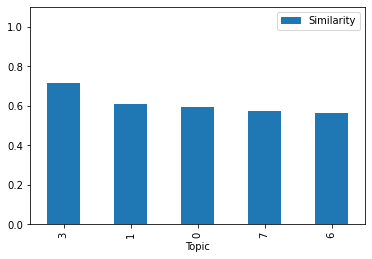

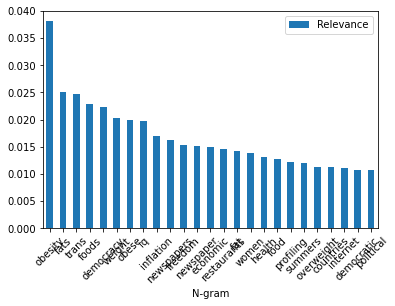

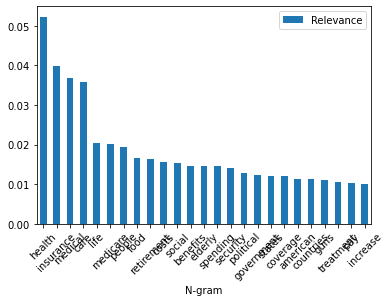

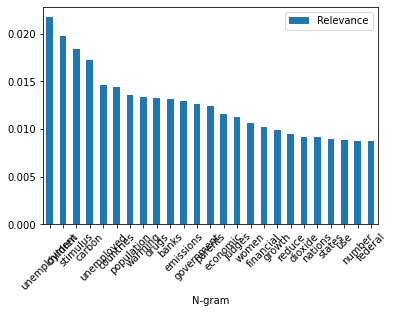

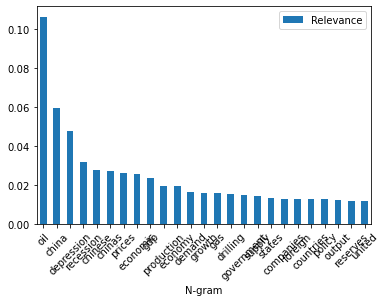

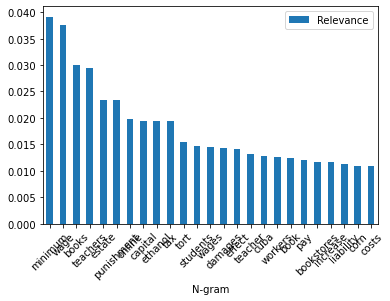

In [39]:
ids, probs = topic_model.find_topics('food')
data = list(zip(ids, probs))
fig = pd.DataFrame(data, columns=['Topic', 'Similarity']).plot.bar(x=0, y=1)
fig.set_ylim([0, 1.1])
for id, prob in data:
    print(f'Topic {id:3}, similarity={prob:.3}')
    topic = topic_model.get_topic(id)
    df = pd.DataFrame(topic, columns=['N-gram', 'Relevance'])
    fig = df.plot.bar(x=0)
    fig.tick_params(axis='x', labelrotation=45)

# Topics over Time

## Initial training
There are a few important parameters that you should take note of, namely:

* `global_tuning`
  * Whether to average the topic representation of a topic at time *t* with its global topic representation
* `evolution_tuning`
  * Whether to average the topic representation of a topic at time *t* with the topic representation of that topic at time *t-1*
* `nr_bins`
  * The number of bins to put our timestamps into. It is computationally inefficient to extract the topics at thousands of different timestamps. Therefore, it is advised to keep this value below 20. 


In [40]:
topics_over_time = topic_model.topics_over_time(docs=all_sents,
                                                timestamps=all_sents_timestamps,
                                                global_tuning=True,
                                                evolution_tuning=True,
                                                nr_bins=11)

11it [00:05,  2.13it/s]


## Visualizing all topics over time

In [46]:
topic_model.visualize_topics_over_time(topics_over_time, custom_labels=True)

## Visualizing topics related to a list of words

In [42]:
wordlist = ['recession']
topics = set()
for row in freq.iterrows():
    topic = topic_model.get_topic(row[0])
    try:
        words = [x[0] for x in topic]
        if any(word in a_word for a_word in words for word in wordlist):
            topics.add(row[0])
    except:
        pass

for topic in topics:
    print('Topic', topic)
    pprint(topic_model.get_topic(topic))
    print()

print(topics)
topic_model.visualize_topics_over_time(topics_over_time[topics_over_time['Topic'].isin(topics)])

Topic 7
[('oil', 0.10618853940829172),
 ('china', 0.05928861593531785),
 ('depression', 0.04742101568723046),
 ('recession', 0.03167396596501563),
 ('chinese', 0.027449439510878897),
 ('chinas', 0.02713289241287787),
 ('prices', 0.025851581862616522),
 ('economic', 0.025723419259946242),
 ('gdp', 0.02322395157250564),
 ('production', 0.019464029920864784),
 ('economy', 0.019293366805466096),
 ('demand', 0.0164573876188832),
 ('growth', 0.016004426807982895),
 ('gas', 0.015572188349272677),
 ('drilling', 0.015502674091707932),
 ('government', 0.01459231191421417),
 ('supply', 0.014458170423242793),
 ('states', 0.012980538357082417),
 ('companies', 0.012892483354541684),
 ('foreign', 0.012703558298984096),
 ('countries', 0.012666196530516566),
 ('policy', 0.012504665228709107),
 ('output', 0.012137521872326845),
 ('reserves', 0.01163935020605765),
 ('united', 0.0115254584301397)]

{7}


## Visualize per list of topics

In [43]:
topics = [9]

topic_model.visualize_topics_over_time(topics_over_time[topics_over_time['Topic'].isin(topics)])

## See topic wordlist evolution over time

In [44]:
topics_over_time[topics_over_time['Topic'] == 9]

,Topic,Words,Frequency,Timestamp,Name
10,9,"college, loans, student, eminent, students",154,2004-12-01 15:00:00.000000000,Rhetoric
25,9,"colleges, college, education, students, instit...",92,2005-10-07 19:38:10.909090944,Rhetoric
40,9,"water, college, education, students, colleges",161,2006-08-10 15:16:21.818181888,Rhetoric
55,9,"college, tuition, students, education, earnings",42,2007-06-13 10:54:32.727272704,Rhetoric
70,9,"college, education, students, school, earnings",34,2008-04-15 06:32:43.636363520,Rhetoric
85,9,"universities, water, colleges, college, students",14,2009-02-16 02:10:54.545454592,Rhetoric
100,9,"colleges, college, forprofit, students, education",76,2009-12-19 21:49:05.454545408,Rhetoric
114,9,"college, tuition, education, students, colleges",119,2010-10-22 17:27:16.363636224,Rhetoric
129,9,"college, loans, student, students, colleges",104,2011-08-25 13:05:27.272727296,Rhetoric
143,9,"college, students, education, student, colleges",64,2012-06-27 08:43:38.181818112,Rhetoric
